<a href="https://colab.research.google.com/github/Manishgadhave/Data-Science/blob/main/Car_Scratch_Detection_using_detectron2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Install Detectron2 Dependencies

In [ ]:
!pip install pyyaml==5.1

import torch
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
# Install detectron2 that matches the above pytorch version

# If there is not yet a detectron2 release that matches the given torch + CUDA version, you need to install a different pytorch.
!pip install 'git+https://github.com/facebookresearch/detectron2.git'
# exit(0)  # After installation, you may need to "restart runtime" in Colab. This line can also restart runtime


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.2/274.2 kB 19.3 MB/s eta 0:00:00
  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  Preparing metadata (setup.py) ... error
error: metadata-generation-failed

× Encountered error while generating package metadata.
╰─> See above for output.

note: This is an issue with the package mentioned above, not pip.
hint: See above for details.
torch:  2.3 ; cuda:  cu121
  Cloning https://github.com/facebookresearch/detectron2.git to /tmp/pip-req-build-y2b_dw42
  Running command git clone --filter=blob:none --quiet https://github.com/facebookresearch/detectron2.git /tmp/pip-req-build-y2b_dw42
  Resolved https://github.com/facebookresearch/detectron2.git to commit bcfd464d0c810f0442d91a349c0f6df945467143
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━

In [ ]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

#Import and Register Custom Detectron2 Data

In [ ]:
!curl -L "https://universe.roboflow.com/ds/NioysdkdSg?key=R5BfGyzWgV" -o roboflow.zip
!unzip roboflow.zip
!rm roboflow.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   901  100   901    0     0   2203      0 --:--:-- --:--:-- --:--:--  2202
100 78.4M  100 78.4M    0     0  10.0M      0  0:00:07  0:00:07 --:--:-- 16.7M
Archive:  roboflow.zip
replace README.dataset.txt? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
 extracting: README.dataset.txt      
replace README.roboflow.txt? [y]es, [n]o, [A]ll, [N]one, [r]ename: A
 extracting: README.roboflow.txt     
 extracting: test/0017_JPEG_jpg.rf.6e21a4cdef446efefa27d29a7ac17de8.jpg  
 extracting: test/0188_jpeg_jpg.rf.7572d5c7f93449febc7490017f42676c.jpg  
 extracting: test/0190_JPEG_jpg.rf.dd834ab9eb00c0d600feaf00f388bfe0.jpg  
 extracting: test/0301_JPEG_jpg.rf.e0370cf5d2d73579213261eae8749c8a.jpg  
 extracting: test/0477_JPEG_jpg.rf.bf3e0884c8c5816a035aa00d4c100190.jpg  
 extracting: test/0511_JPEG_jpg.rf.dffc9ab7072e74ba273ab8f887e746c4.jpg  
 ext

In [ ]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("train_dataset", {}, "/content/train/_annotations.coco.json", "/content/train")
register_coco_instances("test_dataset", {}, "/content/test/_annotations.coco.json", "/content/test")

WARNING [08/09 14:05:19 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[08/09 14:05:19 d2.data.datasets.coco]: Loaded 1600 images in COCO format from /content/train/_annotations.coco.json


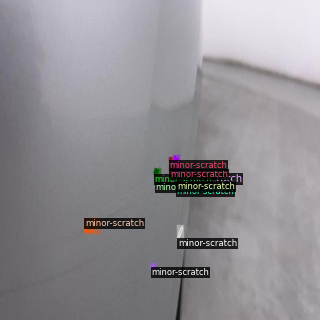

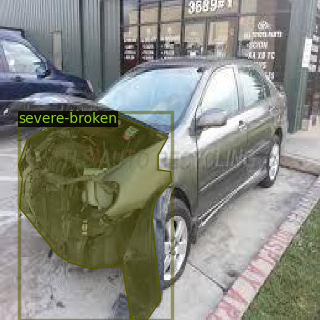

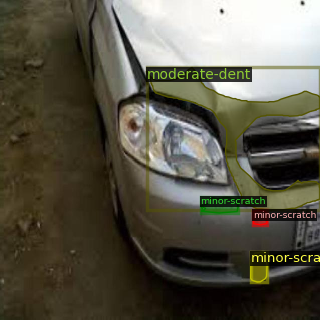

In [ ]:
#visualize training data
my_dataset_train_metadata = MetadataCatalog.get("train_dataset")
dataset_dicts = DatasetCatalog.get("train_dataset")

import random
from detectron2.utils.visualizer import Visualizer

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

#Train Custom Detectron2 Detector

In [ ]:
from detectron2.engine import DefaultTrainer

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("train_dataset",)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.0025  # pick a good LR
cfg.SOLVER.MAX_ITER = 5000   # 300 iterations seems good enough for this toy dataset; you will need to train longer for a practical dataset
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128   # faster, and good enough for this toy dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 8  # (see https://detectron2.readthedocs.io/tutorials/datasets.html#update-the-config-for-new-datasets)
# NOTE: this config means the number of classes, but a few popular unofficial tutorials incorrect uses num_classes+1 here.

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=True)
trainer.train()

[08/09 14:59:27 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}


[08/09 14:59:27 d2.engine.train_loop]: Starting training from iteration 0


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[08/09 14:59:33 d2.utils.events]:  eta: 0:24:57  iter: 19  total_loss: 2.857  loss_cls: 2.152  loss_box_reg: 0.2037  loss_rpn_cls: 0.5328  loss_rpn_loc: 0.05345    time: 0.2955  last_time: 0.2653  data_time: 0.0197  last_data_time: 0.0051   lr: 4.9952e-05  max_mem: 2375M
[08/09 14:59:39 d2.utils.events]:  eta: 0:25:06  iter: 39  total_loss: 1.941  loss_cls: 0.9409  loss_box_reg: 0.1774  loss_rpn_cls: 0.5033  loss_rpn_loc: 0.08677    time: 0.3074  last_time: 0.3320  data_time: 0.0172  last_data_time: 0.0202   lr: 9.9902e-05  max_mem: 2376M
[08/09 14:59:46 d2.utils.events]:  eta: 0:25:00  iter: 59  total_loss: 0.5836  loss_cls: 0.2815  loss_box_reg: 0.0733  loss_rpn_cls: 0.1371  loss_rpn_loc: 0.08955    time: 0.3070  last_time: 0.3409  data_time: 0.0096  last_data_time: 0.0126   lr: 0.00014985  max_mem: 2376M
[08/09 14:59:52 d2.utils.events]:  eta: 0:25:01  iter: 79  total_loss: 0.7276  loss_cls: 0.2303  loss_box_reg: 0.1102  loss_rpn_cls: 0.172  loss_rpn_loc: 0.0764    time: 0.3095  las

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 12792), started 0:48:17 ago. (Use '!kill 12792' to kill it.)

<IPython.core.display.Javascript object>

In [17]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set the testing threshold for this model
cfg.DATASETS.TEST = ("test_dataset", )
predictor = DefaultPredictor(cfg)

[08/09 15:44:20 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


#Inference with Detectron2 Saved Weights

In [18]:
test_metadata = MetadataCatalog.get("test_dataset")

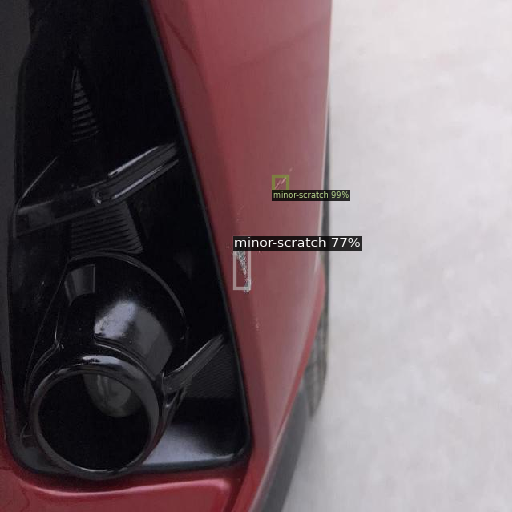

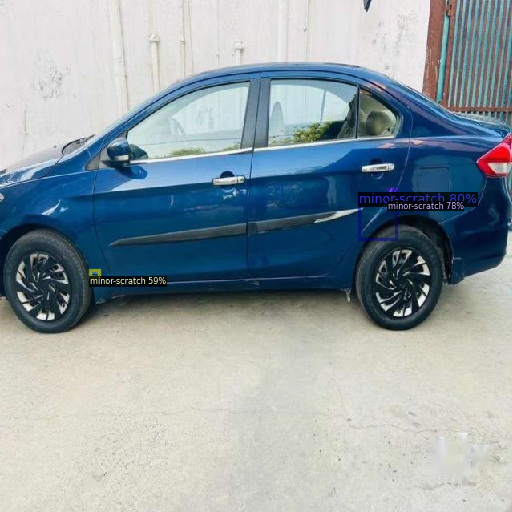

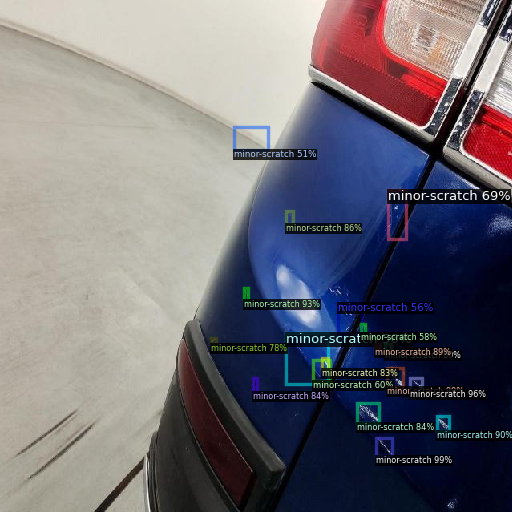

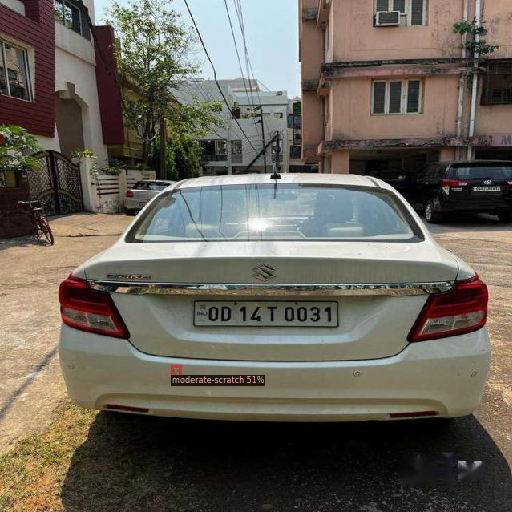

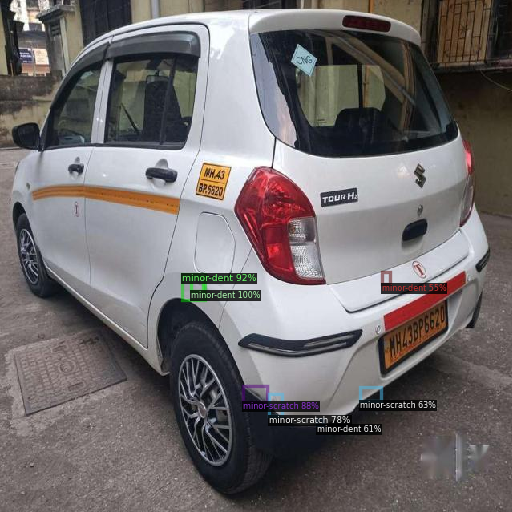

...

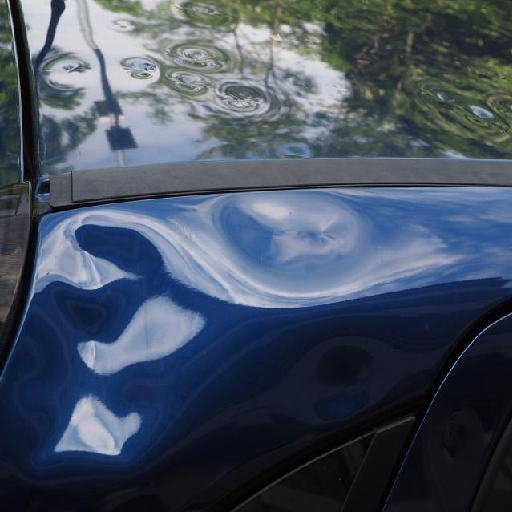

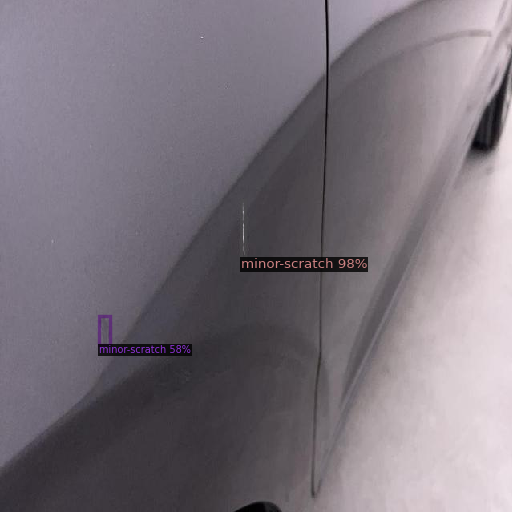

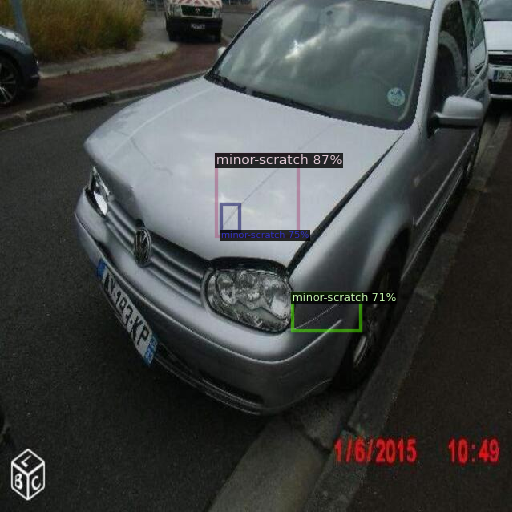

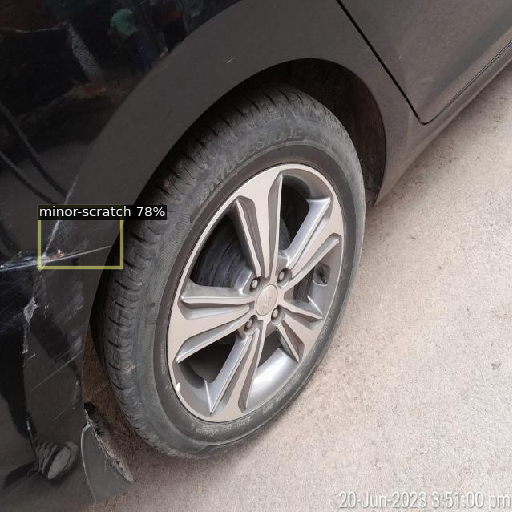

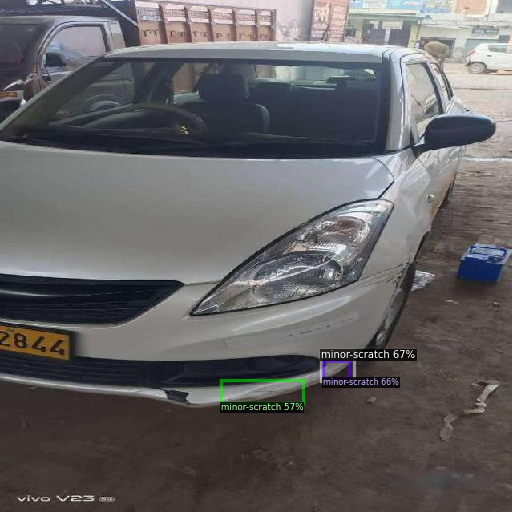

In [19]:
from detectron2.utils.visualizer import ColorMode
import glob

for imageName in glob.glob('/content/test/*jpg'):
  im = cv2.imread(imageName)
  outputs = predictor(im)
  v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata,
                scale=0.8
                 )
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])

#Evaluation

In [20]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("test_dataset", output_dir= "./output")
val_loader = build_detection_test_loader(cfg, "test_dataset")
print(inference_on_dataset(predictor.model, val_loader, evaluator))

WARNING [08/09 15:47:44 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[08/09 15:47:44 d2.data.datasets.coco]: Loaded 76 images in COCO format from /content/test/_annotations.coco.json
[08/09 15:47:44 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[08/09 15:47:44 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[08/09 15:47:44 d2.data.common]: Serializing 76 elements to byte tensors and concatenating them all ...
[08/09 15:47:44 d2.data.common]: Serialized dataset takes 0.05 MiB
[08/09 15:47:44 d2.evaluation.evaluator]: Start inference on 76 batches


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


[08/09 15:47:46 d2.evaluation.evaluator]: Inference done 11/76. Dataloading: 0.0014 s/iter. Inference: 0.0787 s/iter. Eval: 0.0002 s/iter. Total: 0.0803 s/iter. ETA=0:00:05
[08/09 15:47:51 d2.evaluation.evaluator]: Inference done 73/76. Dataloading: 0.0019 s/iter. Inference: 0.0790 s/iter. Eval: 0.0002 s/iter. Total: 0.0813 s/iter. ETA=0:00:00
[08/09 15:47:51 d2.evaluation.evaluator]: Total inference time: 0:00:05.821790 (0.081997 s / iter per device, on 1 devices)
[08/09 15:47:51 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:05 (0.079049 s / iter per device, on 1 devices)
[08/09 15:47:51 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[08/09 15:47:51 d2.evaluation.coco_evaluation]: Saving results to ./output/coco_instances_results.json
[08/09 15:47:51 d2.evaluation.coco_evaluation]: Evaluating predictions with unofficial COCO API...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
[08/09 15:47:51 d2.evaluation.f

In [23]:
#save
f = open('config.yml', 'w')
f.write(cfg.dump())
f.close()